In [1]:
# -*- coding: utf-8 -*- #

# Write libraries here #########################################
import matplotlib.patches as pat
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
from astropy import units as u
from astropy.cosmology import WMAP9 as cosmo
# from astroquery.gama import GAMA
from jupyterthemes import jtplot
from mpl_toolkits.mplot3d import Axes3D
from sklearn import manifold, cluster, preprocessing, mixture
from time import time
from tqdm import tnrange, tqdm_notebook
%matplotlib inline

import seaborn as sns; sns.set(style="ticks", color_codes=True)
# %matplotlib notebook
################################################################

# Showing 500 columns and rows #################################
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)
################################################################

# NOT CHANGE (The PATH for directory) ##########################
CURRENT_DIR_NAME = os.path.dirname(os.path.abspath(__name__))
PATH_DATA = os.path.join(CURRENT_DIR_NAME, '../data/')
PATH_HIST = os.path.join(CURRENT_DIR_NAME, '../histogram/')
PATH_PLOT = os.path.join(CURRENT_DIR_NAME, '../plots/')
PATH_IMG = os.path.join(CURRENT_DIR_NAME, '../images/')
PATH_HTML = os.path.join(CURRENT_DIR_NAME, '../html/')
PATH_TEX = os.path.join(CURRENT_DIR_NAME, '../for_tex/')
################################################################

#When you make plots, jtplot is better.
jtplot.style(theme='grade3', context='notebook', fscale=3, spines=True, gridlines='--', ticks=False, grid=False)

In [2]:
completed_data = pd.read_pickle(PATH_DATA + 'GAMADataForManifold.pickle')

In [3]:
display(completed_data.describe())

,RA,DEC,FUV_flux,FUV_fluxerr,NUV_flux,NUV_fluxerr,u_flux,u_fluxerr,g_flux,g_fluxerr,r_flux,r_fluxerr,i_flux,i_fluxerr,z_flux,z_fluxerr,X_flux,X_fluxerr,Y_flux,Y_fluxerr,J_flux,J_fluxerr,H_flux,H_fluxerr,K_flux,K_fluxerr,W1_flux,W1_fluxerr,W2_flux,W2_fluxerr,W3_flux,W3_fluxerr,W4_flux,W4_fluxerr,P100_flux,P100_fluxerr,P160_flux,P160_fluxerr,S250_flux,S250_fluxerr,S350_flux,S350_fluxerr,S500_flux,S500_fluxerr,Z_TONRY,NQ,KCORR_FUV,KCORR_NUV,KCORR_U,KCORR_G,KCORR_R,KCORR_I,KCORR_Z,KCORR_Y,KCORR_J,KCORR_H,KCORR_K,PCOEFF_R_1,PCOEFF_R_2,PCOEFF_R_3,PCOEFF_R_4,PCOEFF_R_5,COEFFS_1,COEFFS_2,COEFFS_3,COEFFS_4,COEFFS_5,CHI2,MASS,INTSFH,METS,B300,B1000,FUV_flux_kcorrected,NUV_flux_kcorrected,H_flux_kcorrected,I_flux_kcorrected,K_flux_kcorrected,G_flux_kcorrected,Z_flux_kcorrected,Y_flux_kcorrected,J_flux_kcorrected,R_flux_kcorrected,U_flux_kcorrected,R-K,NUV-R
count,73768.000000,73768.000000,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,7.376800e+04,73768.000000,73768.000000,7.376800e+04,73768.000000,7.376800e+04,73768.000000,7.376800e+04,73768.000000,7.376800e+04,73768.000000,73768.000000,73768.000000,7.376800e+04,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,7.376800e+04,7.376800e+04,7.376800e+04,73768.000000,7.376800e+04,73768.000000,7.376800e+04,7.376800e+04,73768.000000,7.376800e+04,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000
mean,189.651980,0.375954,9.691125e-06,1.433836e-06,1.771798e-05,6.959949e-06,3.941530e-05,5.811074e-06,1.233047e-04,6.644793e-06,2.410331e-04,9.234676e-06,3.432591e-04,1.262331e-05,4.200821e-04,2.667000e-05,-4.725897,-4.726298,5.097796e-04,0.000035,6.000265e-04,0.000032,7.329608e-04,0.000037,7.477631e-04,0.000038,0.000396,0.000068,2.707400e-04,0.000066,0.000687,0.000141,0.001333,0.000921,-134.476986,-134.485920,-134.835816,-134.849297,-145.425209,-145.439338,-145.393815,-145.398589,-145.304460,-145.302563,0.200553,4.123956,0.253080,0.121602,0.428708,0.458146,0.203161,0.062516,0.070858,0.099476,-0.018801,0.004191,-0.330487,-0.001001,1.728377,-6.328902,12.690175,-4.808171,3.833503e-06,1.058281e-09,7.237552e-07,0.000009,1.680758e-07,2.194935,2.750862e+10,4.958471e+10,0.029632,1.950617e-02,0.265940,-17.261736,-18.144607,-22.214019,-21.465056,-21.983333,-20.628491,-21.685446,-21.919099,-21.973418,-21.216586,-19.327046,0.766747,3.071979
std,33.758608,1.356445,7.012375e-05,1.041517e-05,1.183519e-04,7.378952e-05,3.199671e-04,2.849965e-05,1.023210e-03,2.587866e-05,1.833359e-03,3.051119e-05,2.540001e-03,3.919699e-05,3.083389e-03,9.312436e-05,68.551593,68.551566,3.493307e-03,0.000169,4.066153e-03,0.000131,4.841449e-03,0.000115,4.133784e-03,0.000131,0.002416,0.000197,1.440871e-03,0.000228,0.006122,0.000378,0.011975,0.000886,341.008456,341.004835,341.402135,341.396708,352.354585,352.348732,352.309926,352.307952,352.212370,352.213152,0.102923,0.373316,0.526796,0.247942,0.360486,0.337047,0.145953,0.143677,0.107124,0.122149,0.091785,0.067802,0.125817,0.003224,0.682940,6.629421,18.311508,17.458761,2.259973e-05,5.150192e-09,2.927421e-06,0.000057,7.691974e-07,22.868611,4.735939e+10,8.489733e+10,0.007677,4.240422e-02,0.187483,1.608674,1.438503,1.445310,1.316428,1.461947,1.188454,1.354942,1.389135,1.407693,1.252013,1.195957,0.359255,1.280014
min,129.000109,-2.993768,3.332060e-10,5.765690e-09,9.628900e-10,3.340650e-08,1.335430e-08,2.499510e-07,4.235320e-08,1.292490e-07,1.538570e-08,1.932670e-07,3.210630e

In [4]:
# Select columns for classification and manifold learning
# X = completed_data[['Z_TONRY', 'FUV_flux_kcorrected', 'NUV_flux_kcorrected',
#                     'U_flux_kcorrected', 'G_flux_kcorrected', 'R_flux_kcorrected', 'I_flux_kcorrected', 'Z_flux_kcorrected',
#                     'Y_flux_kcorrected', 'J_flux_kcorrected', 'H_flux_kcorrected', 'K_flux_kcorrected']]

# Select columns for classification and manifold learning
X_ORIG = completed_data[['FUV_flux_kcorrected', 'NUV_flux_kcorrected',
                    'U_flux_kcorrected', 'G_flux_kcorrected', 'R_flux_kcorrected', 'I_flux_kcorrected', 'Z_flux_kcorrected',
                    'Y_flux_kcorrected', 'J_flux_kcorrected', 'H_flux_kcorrected', 'K_flux_kcorrected']]

In [5]:
x_diff = []

orig_data = np.array(X_ORIG)#[:100,:]
i=0
j=1

p = 0
while i<11:
    while j <11:
        diff = orig_data[:,i] - orig_data[:,j]
        x_diff.append(diff)
#         print(i,j)
        p += 1
        
        j+=1
    i += 1
    j = i+1
    
print(f"p={p}")
x_diff = np.array(x_diff)
X_DIFF = pd.DataFrame(x_diff.T)
# X_DIFF = X_DIFF.sample(frac=1).reset_index(drop=True)
X_DIFF.describe()

p=55


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54
count,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000,73768.000000
mean,0.882871,2.065310,3.366755,3.954850,4.203319,4.423710,4.657363,4.711682,4.952283,4.721597,1.182439,2.483884,3.071979,3.320448,3.540839,3.774492,3.828811,4.069412,3.838726,1.301445,1.889540,2.138010,2.358400,2.592053,2.646372,2.886973,2.656287,0.588095,0.836564,1.056955,1.290608,1.344927,1.585528,1.354842,0.248469,0.468860,0.702512,0.756832,0.997432,0.766747,0.220390,0.454043,0.508362,0.748963,0.518278,0.233653,0.287972,0.528573,0.297887,0.054319,0.294920,0.064235,0.240601,0.009915,-0.230686
std,0.995514,1.361603,1.447497,1.558758,1.635473,1.679660,1.712884,1.729092,1.767449,1.768675,1.033877,1.158971,1.280014,1.360335,1.409895,1.445769,1.463245,1.504924,1.505138,0.547913,0.643531,0.723282,0.780430,0.811535,0.832902,0.878915,0.884603,0.172508,0.280614,0.363481,0.393364,0.422038,0.485818,0.494625,0.128785,0.225482,0.243735,0.276167,0.350396,0.359255,0.159317,0.158098,0.191350,0.276239,0.283627,0.157525,0.176588,0.251877,0.255389,0.090696,0.185457,0.180701,0.156530,0.143496,0.164572
min,-9.111224,-5.804138,-5.965029,-7.268533,-6.942234,-6.837052,-5.921695,-3.637670,-3.478928,-3.737771,-4.718561,-3.834861,-2.575391,-2.327989,-2.728525,-2.446400,-3.504638,-3.005930,-4.191618,-3.000651,-4.304155,-3.977856,-3.872674,-2.957317,-4.008833,-2.950851,-3.973851,-1.303503,-2.166429,-3.526895,-3.381023,-4.103907,-3.709467,-5.088916,-1.940312,-3.813825,-3.558292,-4.173092,-4.288894,-5.543778,-4.097666,-3.710759,-4.037228,-4.839869,-5.855722,-4.421171,-5.038765,-4.461581,-6.068881,-3.398492,-4.617328,-6.276434,-4.619629,-6.100928,-5.577104
25%,0.396928,1.207778,2.327079,2.812168,2.994479,3.190524,3.389938,3.433777,3.652055,3.414967,0.584734,1.683730,2.162414,2.341424,2.533181,2.730013,2.767247,2.984861,2.747701,0.973441,1.463547,1.642604,1.832842,2.030682,2.068361,2.283446,2.050288,0.465404,0.636640,0.822406,1.018051,1.056109,1.272009,1.032592,0.168574,0.349983,0.547213,0.583382,0.797449,0.557278,0.162724,0.368595,0.406428,0.617748,0.377190,0.161523,0.205460,0.415776,0.174714,0.015310,0.227452,-0.015575,0.191090,-0.048636,-0.277942
50%,0.747496,1.842982,3.070787,3.663646,3.927112,4.171996,4.413001,4.479980,4.735457,4.507436,1.000400,2.196345,2.790871,3.058134,3.300425,3.545301,3.610397,3.865422,3.639255,1.192820,1.789046,2.056858,2.306853,2.546478,2.614102,2.871181,2.645595,0.594673,0.864066,1.105454,1.347605,1.413779,1.668792,1.441173,0.267349,0.508273,0.750335,0.811741,1.065096,0.833667,0.243057,0.482086,0.541102,0.792322,0.559671,0.242028,0.303972,0.554234,0.319848,0.057402,0.306495,0.071851,0.250419,0.018207,-0.228720
75%,1.271850,2.756030,4.168403,4.868629,5.193147,5.460195,5.727149,5.800215,6.075255,5.857913,1.586113,2.996622,3.708544,4.045664,4.320242,4.592840,4.672033,4.954731,4.734458,1.503832,2.204037,2.534481,2.813697,3.077378,3.152568,3.431728,3.205811,0.717107,1.051936,1.326576,1.594509,1.662912,1.938613,1.709687,0.338102,0.619601,0.881355,0.950224,1.225209,0.999780,0.304122,0.557421,0.626654,0.904408,0.679040,0.309230,0.379881,0.657111,0.433029,0.099066,0.372259,0.150296,0.299907,0.077829,-0.176669
max,9.457386,10.733571,11.970005,13.045792,13.403488,13.565696,13.8

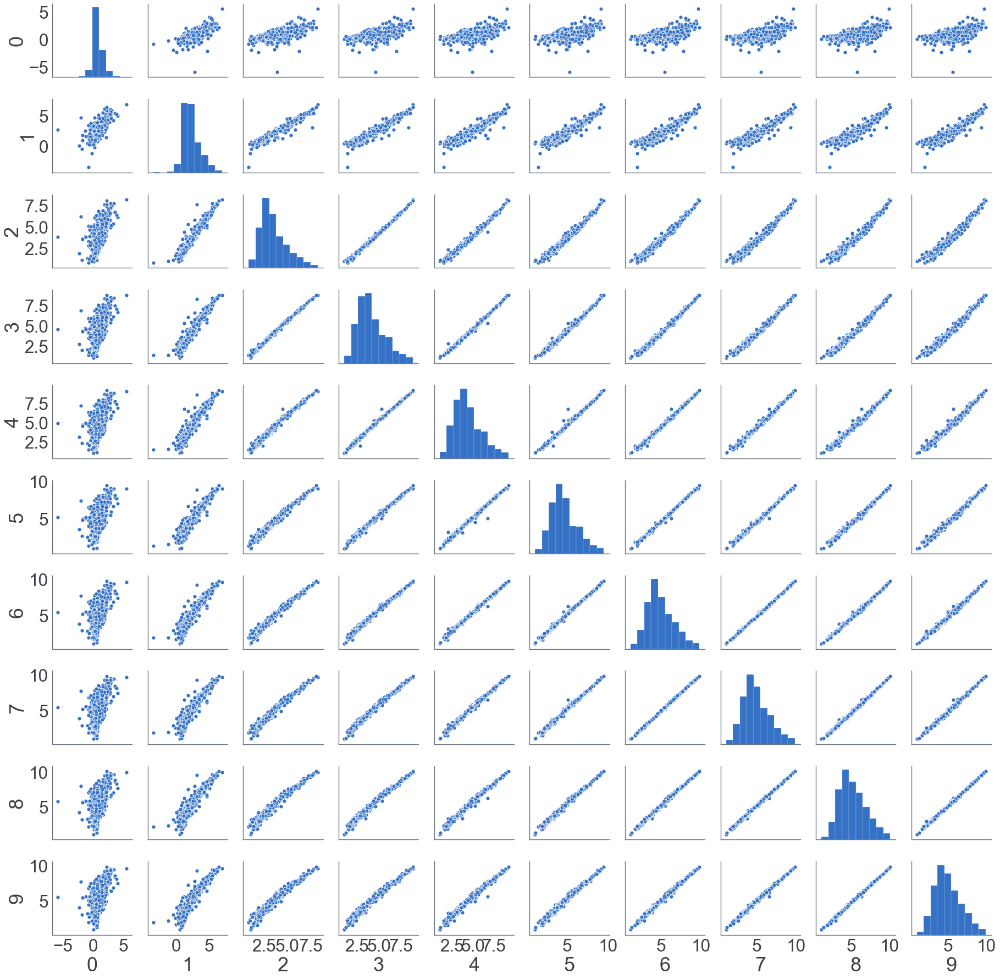

In [6]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:500,:10]))

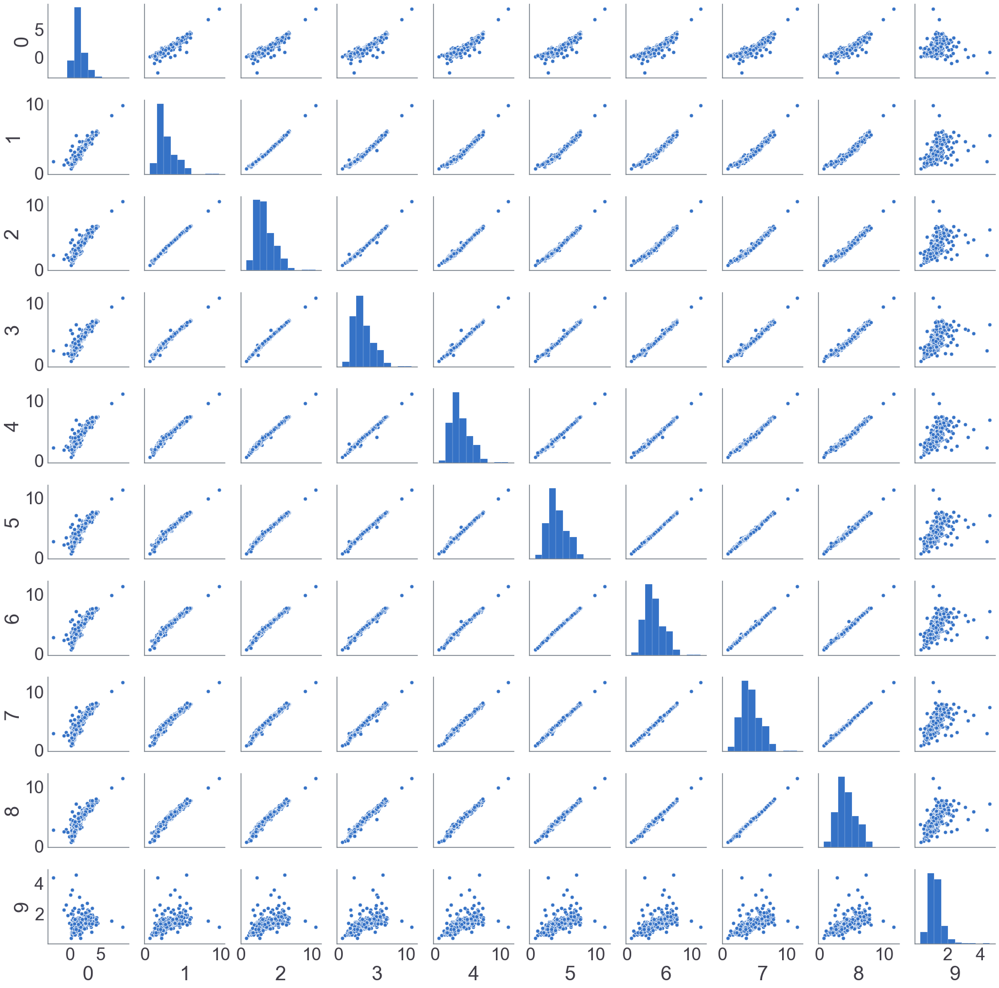

In [7]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:500,10:20]))

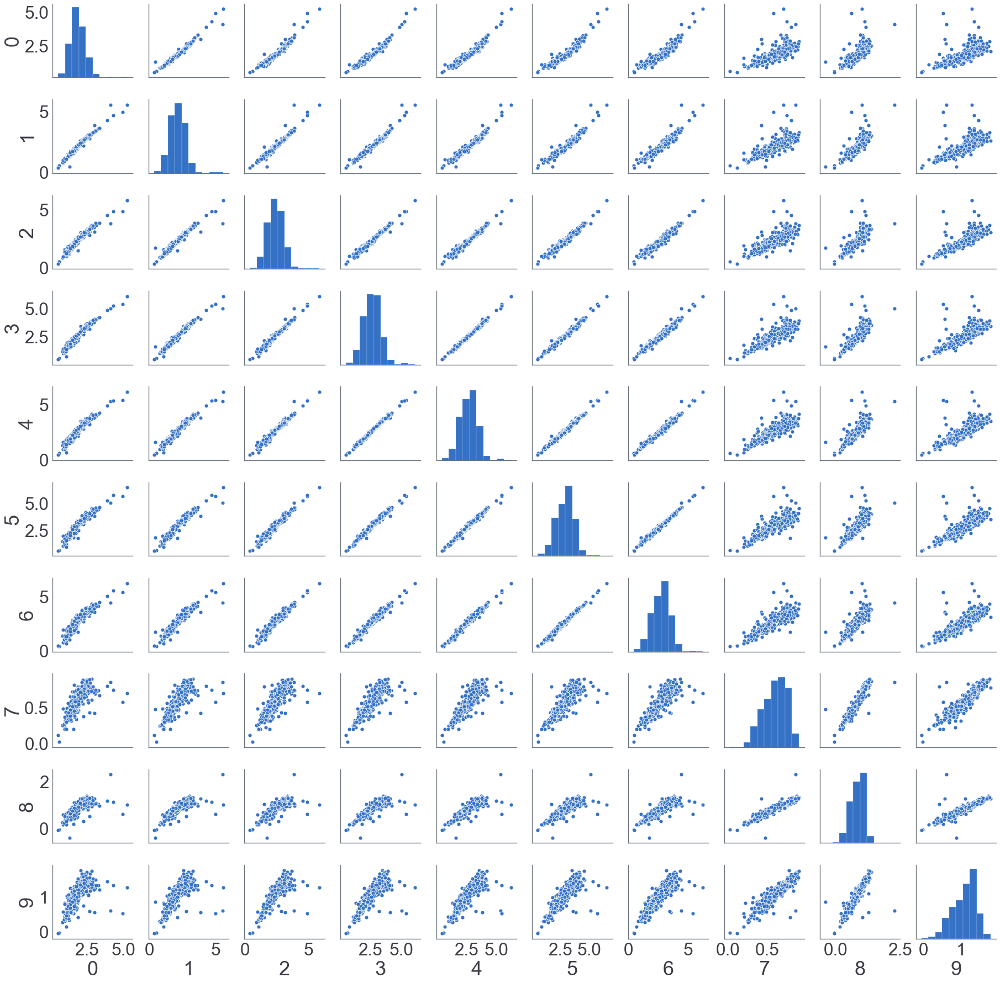

In [8]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:500,20:30]))

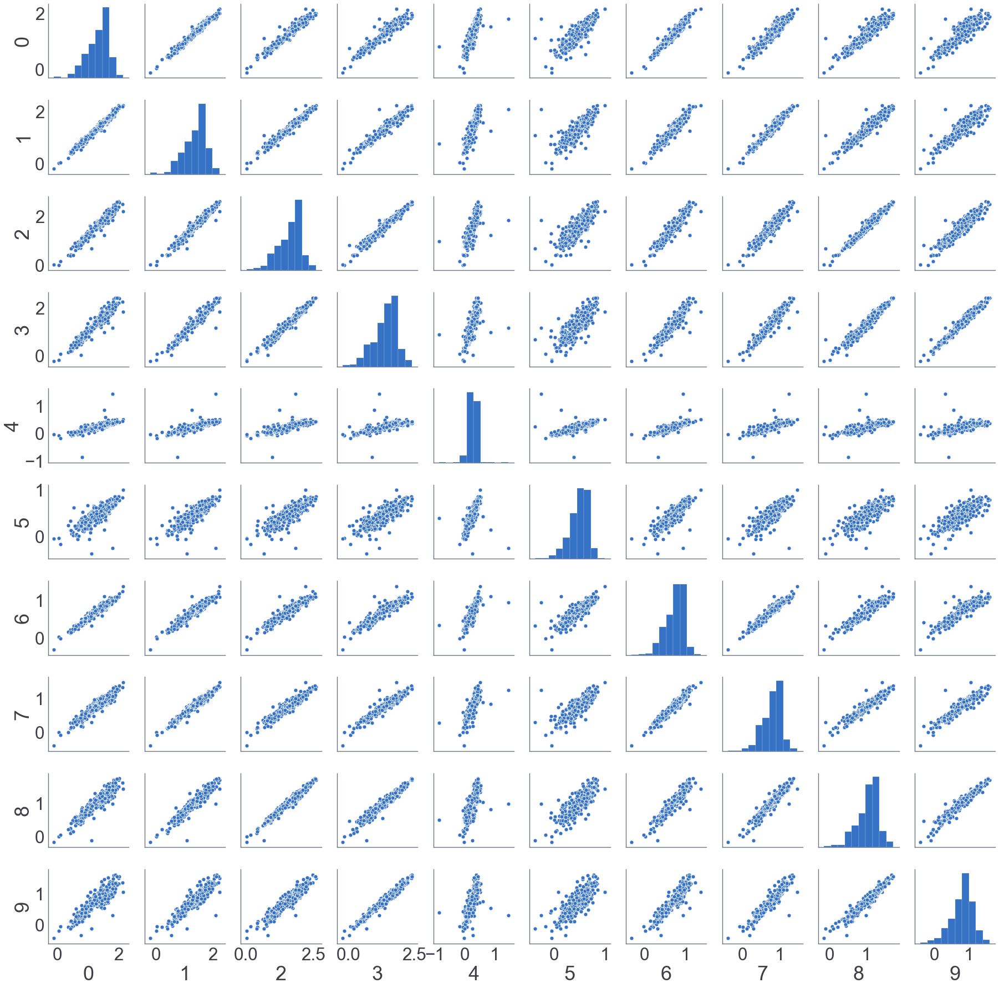

In [9]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:500,30:40]))

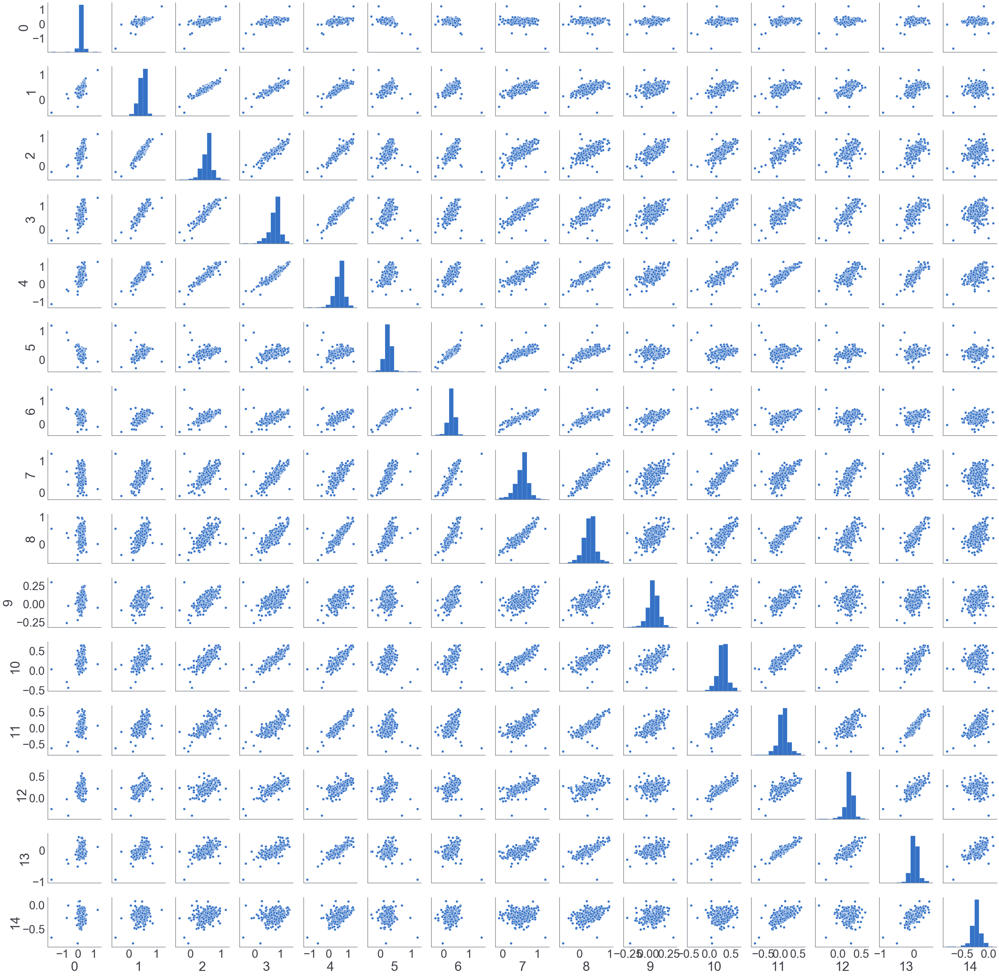

In [10]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:500,40:]))

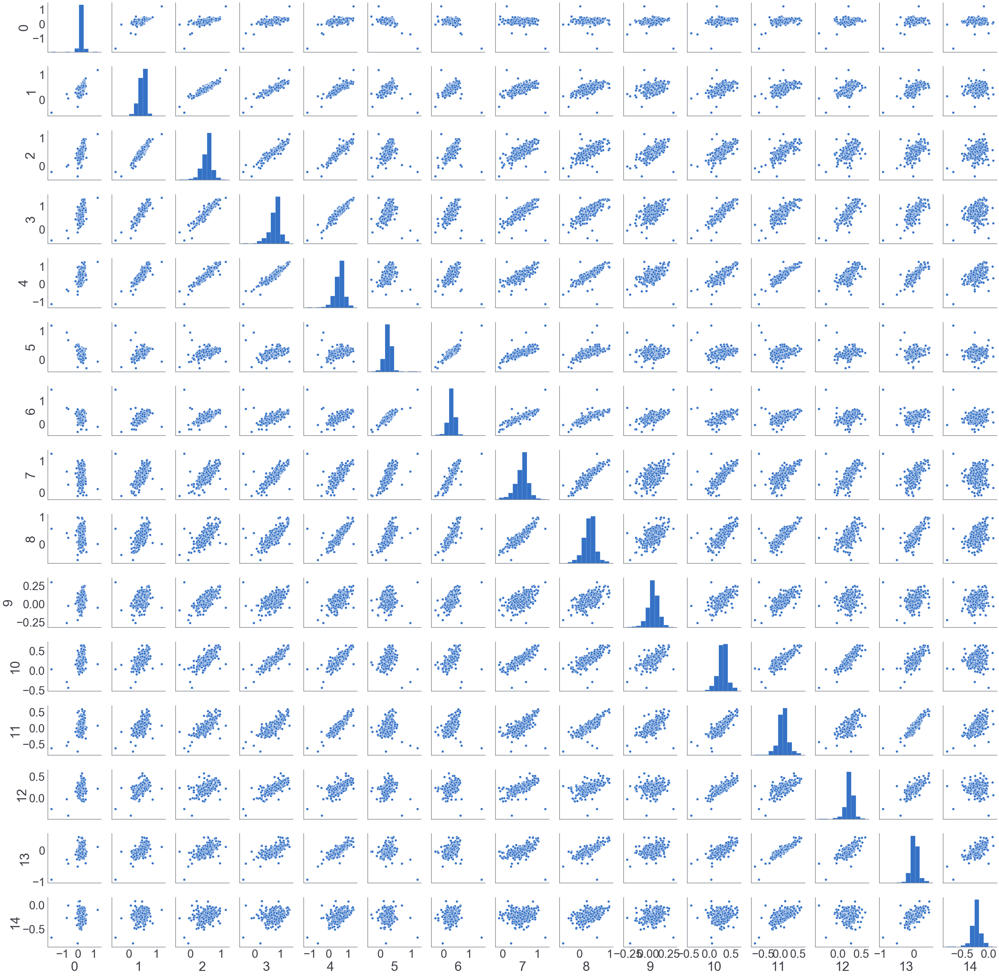

In [10]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:500,40:]))

In [13]:
# pd.DataFrame(np.array(X_DIFF)[:500,:10]).describe()
fig_pairplot_200 = sns.pairplot(pd.DataFrame(np.array(X_DIFF)[:200,:]))

<Figure size 7200x7200 with 0 Axes>

In [ ]:
# fig_pairplot_200.savefig('colors_pairplot_200.png', dpi = 400)
# try:
#     fig_pairplot_200.savefig('colors_pairplot_200.png', dpi = 300)
# except:
#     fig_pairplot_200.savefig('colors_pairplot_200.png')

In [12]:
# LABELS
i=0
j=1

p = 0
while i<11:
    while j <11:
#         diff = orig_data[:,i] - orig_data[:,j]
#         x_diff.append(diff)

        print(f"{p}th data is {i}-{j}")
        p += 1
        
        j+=1
    i += 1
    j = i+1
    
print(f"p={p}")

0th data is 0-1
1th data is 0-2
2th data is 0-3
3th data is 0-4
4th data is 0-5
5th data is 0-6
6th data is 0-7
7th data is 0-8
8th data is 0-9
9th data is 0-10
10th data is 1-2
11th data is 1-3
12th data is 1-4
13th data is 1-5
14th data is 1-6
15th data is 1-7
16th data is 1-8
17th data is 1-9
18th data is 1-10
19th data is 2-3
20th data is 2-4
21th data is 2-5
22th data is 2-6
23th data is 2-7
24th data is 2-8
25th data is 2-9
26th data is 2-10
27th data is 3-4
28th data is 3-5
29th data is 3-6
30th data is 3-7
31th data is 3-8
32th data is 3-9
33th data is 3-10
34th data is 4-5
35th data is 4-6
36th data is 4-7
37th data is 4-8
38th data is 4-9
39th data is 4-10
40th data is 5-6
41th data is 5-7
42th data is 5-8
43th data is 5-9
44th data is 5-10
45th data is 6-7
46th data is 6-8
47th data is 6-9
48th data is 6-10
49th data is 7-8
50th data is 7-9
51th data is 7-10
52th data is 8-9
53th data is 8-10
54th data is 9-10
p=55
